# **Stock Price Clustering: Grouping Companies Based on Market Performance**

## **Introduction**

This project aims to analyze and group companies from the S&P 500 based on their stock price behavior over a given time frame (2010–2020). By applying clustering algorithms, I can identify patterns among companies with similar market behavior. This clustering approach reveals hidden relationships and market segmentations, allowing for insights into which companies exhibit comparable trends despite potentially belonging to different sectors.

### **Project Objectives**
1. **Data Collection**: Gather historical stock price data for S&P 500 companies using the Yahoo Finance API.
2. **Preprocessing**: Standardize the data to ensure consistent scaling, essential for clustering algorithms.
3. **Clustering Analysis**: Use machine learning techniques like K-Means to cluster companies based on their historical stock price data.
4. **Dimensionality Reduction and Visualization**: Apply techniques such as PCA (Principal Component Analysis) and t-SNE (t-distributed Stochastic Neighbor Embedding) to reduce the complexity of the data, allowing for meaningful visualizations of the clustered groups.


In [1]:
import pandas as pd
import yfinance as yf
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.pipeline import Pipeline
from sklearn.metrics import silhouette_score
from yellowbrick.cluster import KElbowVisualizer
from sklearn.metrics import calinski_harabasz_score
from sklearn.datasets import make_blobs
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import scipy.stats as stats

np.random.seed(42)

# **Download Stock Data from Yahoo Finance**

The first step in my analysis is gathering the necessary data. For this, I fetch a list of companies in the S&P 500 index and then download historical stock price data for each company over the past 10 years. The Yahoo Finance API provides a convenient way to access daily stock price data, which will serve as the basis for my clustering analysis.

### Steps:
1. **Fetch S&P 500 Company List**: I retrieve a current list of S&P 500 companies, which includes their ticker symbols—essential for accessing individual stock data.
2. **Download Historical Data**: Using the Yahoo Finance API, I pull 10 years of daily stock prices for each company.
3. **Data Storage**: I store the downloaded stock data in a DataFrame for further preprocessing and analysis.





```
# Download historical data for all S&P 500 tickers
stockdata = yf.download(tickers, start="2010-01-01", end="2020-01-01")
stockdata_adj_close = stockdata['Adj Close']
stockdata_adj_close.to_csv('stockdata.csv', index=False)
```





I choose the period from 01/01/2010 to 01/01/2020 to avoid covering the Great Recession (2007/2008) and the COVID period (2020). This global crisis could cause problems because its impact could affect the whole structure.

In [2]:
# URL for the S&P 500 companies on Wikipedia
url = "https://en.wikipedia.org/wiki/List_of_S%26P_500_companies"
tables = pd.read_html(url)
sp500 = tables[0]

sp500 = sp500[['Symbol', 'Security']]
sp500.columns = ['Ticker', 'Name']

tickers = sp500['Ticker'].tolist()

In [3]:
#import data
stockdata = pd.read_csv('stockdata.csv')
stockdata.head()

,A,AAPL,ABBV,ABNB,ABT,ACGL,ACN,ADBE,ADI,ADM,...,WTW,WY,WYNN,XEL,XOM,XYL,YUM,ZBH,ZBRA,ZTS
0,20.084951,6.447411,NaN,NaN,18.763714,7.994444,32.071804,37.090000,22.353203,21.440174,...,52.707298,9.774273,41.295700,12.678843,39.594814,NaN,18.969763,52.470432,28.670000,NaN
1,19.866770,6.458559,NaN,NaN,18.612112,7.967778,32.270020,37.700001,22.317902,21.555994,...,52.589180,9.981770,43.807278,12.528472,39.749416,NaN,18.904892,54.131439,28.620001,NaN
2,19.796185,6.355825,NaN,NaN,18.715467,7.933333,32.613083,37.619999,22.275553,21.501493,...,53.435799,9.871400,43.232651,12.552535,40.092968,NaN,18.769735,54.113953,28.400000,NaN
3,19.770519,6.344077,NaN,NaN,18.870522,7.886667,32.582588,36.889999,22.099102,21.276670,...,53.278278,9.827249,44.155937,12.498398,39.966999,NaN,18.764326,55.355339,27.690001,NaN
4,19.764101,6.386255,NaN,NaN,18.966991,7.871111,32.452976,36.689999,22.226158,21.010965,...,53.219227,9.736745,43.839565,12.504413,39.806667,NaN,18.769735,54.192631,27.600000,NaN


## **Fetching Sector Data for Enhanced Cluster Analysis**

In addition to historical stock price data, I collect sector information for each S&P 500 company. This sector data allows me to enrich the cluster analysis by examining how companies are grouped not only by stock performance, but also by sector.
### Purpose:
Later in the analysis, I use crosstabulation to examine the relationships between clusters and sectors, which helps to identify any sectoral patterns within the clusters. This step provides insight into whether companies from the same sector tend to group together based on share behaviour, or whether there are unexpected cross-sector relationships. It is also possible to use more clusters than usual to identify several sub-classes belonging to the same sector.

It is important to note that the sector allocation (here from Yahoo Finance) is very sensitive. There are different sector groups depending on who creates the groups, and therefore the same companies are categorised in different groups. The results based on the crosstabulation must always be considered in relation to the sector groups.

In [4]:
sector_data = []

for ticker in tickers:
    stock_info = yf.Ticker(ticker).info
    sector = stock_info.get('sector', 'N/A')  # Fetch sector information, 'N/A' if not found
    sector_data.append({'Ticker': ticker, 'Sector': sector})

sector_sp500 = pd.DataFrame(sector_data)
sector_sp500 = pd.merge(sector_sp500, sp500, on='Ticker')

print(sector_sp500.head())

  Ticker       Sector                 Name
0    MMM  Industrials                   3M
1    AOS  Industrials          A. O. Smith
2    ABT   Healthcare  Abbott Laboratories
3   ABBV   Healthcare               AbbVie
4    ACN   Technology            Accenture


Sector
Technology                82
Industrials               70
Financial Services        66
Healthcare                63
Consumer Cyclical         55
Consumer Defensive        36
Utilities                 32
Real Estate               31
Basic Materials           22
Communication Services    22
Energy                    22
N/A                        2
Name: count, dtype: int64


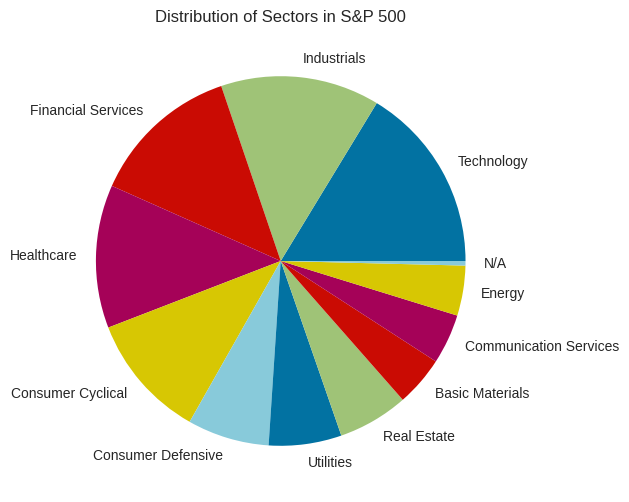

In [5]:
plt.figure(figsize=(10, 6))
sector_counts = sector_sp500['Sector'].value_counts()
print(sector_counts)
sector_counts.plot(kind='pie')
plt.title('Distribution of Sectors in S&P 500')
plt.ylabel('')
plt.show()

# **Data Cleaning**

Data cleaning is a crucial step, especially when working with financial data, where inconsistencies or missing values can significantly impact the analysis. For this analysis, I focus on the "Adj Close" (adjusted closing price) variable.

### Steps:
1. **Filter Columns with Excessive Missing Data**: I start by dropping all tickers (columns) that contain more than one month of missing data. This helps ensure that the dataset only includes stocks with relatively complete histories, improving the reliability of the results.
2. **Drop Remaining Missing Values**: After removing tickers with excessive missing data, I drop any rows with remaining missing values. By handling missing data in this order, I minimize data loss while maintaining the integrity of the time series.
3. **Outlier removal**: To deal with extreme outliers that could skew the analysis, I apply the IQR method to each ticker. I calculate the IQR and filter out values that are significantly out of range by a factor of 4.5 to obtain only the extreme outliers (3 times the normal parameter for outliers). This step ensures that abnormal price spikes or drops do not disproportionately affect the clustering results, while preserving the structure of the data.



In [6]:
#stockdata_adj_close = stockdata['Adj Close']

null_counts = stockdata.isnull().sum()
print(null_counts[null_counts > 0])

# Drop all Tickers, if they have more than 1 month (30 days) of missing data
threshold = stockdata.shape[0] - 30
stockdata_cleaned = stockdata.dropna(axis=1, thresh=threshold)

print(stockdata.shape)
print(stockdata_cleaned.shape)

null_counts = stockdata_cleaned.isnull().sum()
print(null_counts[null_counts > 0])

# Drop rows with NAs
stockdata_cleaned.dropna(axis=0, inplace=True)

null_counts = stockdata_cleaned.isnull().sum()
print(null_counts[null_counts > 0])

print(stockdata_cleaned.shape)
stockdata_cleaned.head()

ABBV     754
ABNB    2516
ALLE     976
AMCR     596
AMTM    2516
        ... 
VICI    2013
VLTO    2516
VST     1701
XYL      449
ZTS      775
Length: 75, dtype: int64
(2516, 503)
(2516, 430)
CHTR     1
GNRC    27
dtype: int64
Series([], dtype: int64)
(2489, 430)


<ipython-input-6-d7729ed843f6>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  stockdata_cleaned.dropna(axis=0, inplace=True)


,A,AAPL,ABT,ACGL,ACN,ADBE,ADI,ADM,ADP,ADSK,...,WRB,WST,WTW,WY,WYNN,XEL,XOM,YUM,ZBH,ZBRA
27,18.840076,5.985268,18.581450,7.961111,30.699585,32.639999,19.529932,20.459127,25.247702,24.180000,...,5.525782,16.268976,54.794327,8.756168,41.941364,12.203680,37.599670,18.156675,50.354828,29.280001
28,19.237923,6.036787,18.716812,8.060000,30.867306,31.450001,19.755793,20.281988,25.056335,24.219999,...,5.536816,16.349632,54.636818,8.738486,40.701702,12.167594,37.346085,18.140366,50.040119,29.330000
29,19.411175,6.127767,18.945871,8.140000,31.134125,31.809999,20.186337,20.186131,25.494612,25.240000,...,5.565505,16.484047,54.892780,8.946231,41.909073,12.390135,38.199051,18.270868,51.019226,29.530001
30,19.655016,6.102161,19.001390,8.038889,31.096012,32.330002,20.031059,20.460020,25.593382,25.879999,...,5.550057,16.564693,55.621258,8.910872,41.586246,12.360062,37.899376,18.303490,51.001747,29.660000
31,19.879608,6.113609,19.077753,8.000000,31.492420,33.240002,20.870983,20.521646,25.426706,25.920000,...,5.636121,17.478729,55.483452,8.972753,40.036694,12.534478,38.014626,18.308931,51.054199,29.730000


In [7]:
outlier_counts = {}
cleaned_columns = []

for column in stockdata_cleaned.columns:
    Q1 = stockdata_cleaned[column].quantile(0.25)
    Q3 = stockdata_cleaned[column].quantile(0.75)

    IQR = Q3 - Q1

    para = 3
    lower_bound = Q1 - para * IQR
    upper_bound = Q3 + para * IQR

    outlier_mask = (stockdata_cleaned[column] < lower_bound) | (stockdata_cleaned[column] > upper_bound)
    outlier_count = outlier_mask.sum()
    outlier_counts[column] = outlier_count

    # Remove outliers from the current column and store in the cleaned_columns list
    cleaned_column = stockdata_cleaned[column][~outlier_mask]
    cleaned_columns.append(cleaned_column.reset_index(drop=True))

stockdata_cleaned_no_outliers = pd.concat(cleaned_columns, axis=1)
stockdata_cleaned_no_outliers.columns = stockdata_cleaned.columns

# Drop all Tickers, if they have more than 1 month (30 days) of missing data
threshold = stockdata_cleaned_no_outliers.shape[0] - 30
stockdata_cleaned_no_outliers = stockdata_cleaned_no_outliers.dropna(axis=1, thresh=threshold)

stockdata_cleaned_no_outliers.dropna(axis=0, inplace=True)

print("Outliers Count for Each Column:\n", {col: count for col, count in outlier_counts.items() if count > 0})
print("Shape of DataFrame after removing outliers:", stockdata_cleaned_no_outliers.shape)
stockdata_cleaned_no_outliers.head()

Outliers Count for Each Column:
 {'AES': 76, 'AMD': 40, 'CPRT': 29, 'FAST': 33, 'FE': 60, 'FSLR': 85, 'FTNT': 31, 'LULU': 230, 'MTCH': 280, 'PODD': 103}
Shape of DataFrame after removing outliers: (2460, 421)


,A,AAPL,ABT,ACGL,ACN,ADBE,ADI,ADM,ADP,ADSK,...,WRB,WST,WTW,WY,WYNN,XEL,XOM,YUM,ZBH,ZBRA
0,18.840076,5.985268,18.581450,7.961111,30.699585,32.639999,19.529932,20.459127,25.247702,24.180000,...,5.525782,16.268976,54.794327,8.756168,41.941364,12.203680,37.599670,18.156675,50.354828,29.280001
1,19.237923,6.036787,18.716812,8.060000,30.867306,31.450001,19.755793,20.281988,25.056335,24.219999,...,5.536816,16.349632,54.636818,8.738486,40.701702,12.167594,37.346085,18.140366,50.040119,29.330000
2,19.411175,6.127767,18.945871,8.140000,31.134125,31.809999,20.186337,20.186131,25.494612,25.240000,...,5.565505,16.484047,54.892780,8.946231,41.909073,12.390135,38.199051,18.270868,51.019226,29.530001
3,19.655016,6.102161,19.001390,8.038889,31.096012,32.330002,20.031059,20.460020,25.593382,25.879999,...,5.550057,16.564693,55.621258,8.910872,41.586246,12.360062,37.899376,18.303490,51.001747,29.660000
4,19.879608,6.113609,19.077753,8.000000,31.492420,33.240002,20.870983,20.521646,25.426706,25.920000,...,5.636121,17.478729,55.483452,8.972753,40.036694,12.534478,38.014626,18.308931,51.054199,29.730000


## **Calculating Daily Returns and Volatility**

After preparing and cleaning the stock price data, the next step is to calculate key metrics—daily returns and volatility—that will serve as foundational inputs for the clustering analysis. These robust metrics provide insights into each stock's price movements and risk level, respectively, over time.
For the volatility, I choose the rolling method in order to get the volatility for the next 30 days.

In [8]:
tickers = stockdata_cleaned_no_outliers.columns.tolist()

daily_return = pd.DataFrame()
daily_volatility = pd.DataFrame()

daily_return = stockdata_cleaned_no_outliers.pct_change()
daily_volatility = daily_return.rolling(window=30).std()

daily_return.dropna(inplace=True)
daily_volatility.dropna(inplace=True)

daily_return.info()
daily_volatility.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2459 entries, 1 to 2459
Columns: 421 entries, A to ZBRA
dtypes: float64(421)
memory usage: 7.9 MB
<class 'pandas.core.frame.DataFrame'>
Index: 2430 entries, 30 to 2459
Columns: 421 entries, A to ZBRA
dtypes: float64(421)
memory usage: 7.8 MB


# **Exploratory Data Analysis (EDA)**

Before diving into the clustering process, it’s essential to perform an Exploratory Data Analysis (EDA) to understand the dataset’s characteristics and identify potential issues. EDA plays a crucial role in data cleaning, helping to uncover patterns, relationships, and distributions within the data. These insights inform the clustering strategy and guide necessary adjustments, ensuring a robust foundation for analysis.


In [214]:
# fix parameters
n_tickers = len(tickers)
n_cols = 4
n_rows = (n_tickers + n_cols - 1) // n_cols

# Boxplot
y_lim = (daily_return.min().min(), daily_return.max().max())

fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, n_rows * 4))
axs = axs.flatten()

for i, ticker in enumerate(tickers):
    axs[i].boxplot(daily_return[ticker])
    axs[i].set_title(ticker)
    axs[i].set_ylim(y_lim)
    axs[i].set_ylabel('Adjusted Close')

for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()

In [215]:
# Boxplot
y_lim = (daily_volatility.min().min(), daily_volatility.max().max())

fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, n_rows * 4))
axs = axs.flatten()

for i, ticker in enumerate(tickers):
    axs[i].boxplot(daily_volatility[ticker])
    axs[i].set_title(ticker)
    axs[i].set_ylim(y_lim)
    axs[i].set_ylabel('Adjusted Close')


for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()

## **Interpreting Boxplots**
The boxplots reveal a number of outliers, which is expected given that I’m analyzing stock data type of data highly sensitive to both broad market behaviors and individual company events. Removing too many outliers could disrupt the natural structure of the data or overly reduce the sample size, potentially skewing the analysis. For these reasons, I’ve decided to retain these outliers, as they are an inherent aspect of stock performance and could provide valuable insights into market dynamics.

Next, I look at the line plots to see if there are any data points that look out of place.

In [216]:
# lineplots
y_lim = (daily_return.min().min(), daily_return.max().max())

fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, n_rows * 4))
axs = axs.flatten()

for i, ticker in enumerate(tickers):
    axs[i].plot(daily_return[ticker], label=ticker)
    axs[i].set_title(ticker)
    axs[i].set_ylim(y_lim)

for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()

In [217]:
# lineplots
y_lim = (0, daily_return.max().max()/3)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, n_rows * 4))

axs = axs.flatten()

for i, ticker in enumerate(tickers):
    axs[i].plot(daily_volatility[ticker], label=ticker)
    axs[i].set_title(ticker)
    axs[i].set_ylim(y_lim)

for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()

## **Interpreting the line plots**

The line plots of daily returns and volatility look pretty good (except for the outliers). This looks like some structure, which means that there may be underlying patterns.

Finally, I look at the histograms to get an idea of the distribution of the data, as this helps to understand the underlying characteristics of the returns and volatility. Analyzing the distribution is important for clustering analysis because it allows me to identify whether the data follows a normal distribution, is skewed, or has heavy tails, which can influence the choice of clustering algorithms and their effectiveness. Understanding the shape of the distribution also helps in detecting potential outliers or anomalies, ensuring that the clustering model accurately captures the natural groupings in the data.

In [218]:
x_lim = (daily_return.min().min()/2, daily_return.max().max()/2)
y_lim = (0, daily_return.count().max() / 4)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, n_rows * 4))

axs = axs.flatten()

for i, ticker in enumerate(daily_return.columns):
    axs[i].hist(daily_return[ticker], bins=50)
    axs[i].set_title(f'Daily Returns for {ticker}', fontsize=12)
    axs[i].set_xlabel('Daily Return')
    axs[i].set_ylabel('Frequency')
    axs[i].set_xlim(x_lim)
    axs[i].set_ylim(y_lim)

for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()

In [219]:
x_lim = (daily_volatility.min().min()/2, daily_volatility.max().max()/2)
y_lim = (0, daily_return.count().max() / 4)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, n_rows * 4))

axs = axs.flatten()

for i, ticker in enumerate(daily_volatility.columns):
    axs[i].hist(daily_volatility[ticker], bins=50)
    axs[i].set_title(f'volatility for {ticker}', fontsize=12)
    axs[i].set_xlabel('volatility')
    axs[i].set_ylabel('Frequency')
    axs[i].set_xlim(x_lim)
    axs[i].set_ylim(y_lim)


for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()

## **Normal Distribution - Shapiro-Wilk Test**
The boxplots initially suggested non-normal distributions for the daily returns and volatility across most tickers. To confirm this observation, I performed the Shapiro-Wilk test, which tests the null hypothesis that the data comes from a normal distribution. For most tickers, I expect the p-values to be less than 0.05, reinforcing the indication that their distributions deviate from normality.

In [220]:
volatility_normality = {}
returns_normality = {}

for i, ticker in enumerate(daily_volatility.columns):
    stat, p_value = stats.shapiro(daily_volatility[ticker])
    volatility_normality[ticker] = (stat, p_value)

for i, ticker in enumerate(daily_return.columns):
    stat, p_value = stats.shapiro(daily_return[ticker])
    returns_normality[ticker] = (stat, p_value)

print("Volatility Normality Test Results:")
for ticker, result in volatility_normality.items():
    print(f"{ticker}: Statistic = {result[0]:.4f}, p-value = {result[1]:.4f}")
    if result[1] < 0.05:
        print(f"  -> {ticker} p-value < 0.05: Likely not normal")

print("\nReturns Normality Test Results:")
for ticker, result in returns_normality.items():
    print(f"{ticker}: Statistic = {result[0]:.4f}, p-value = {result[1]:.4f}")
    if result[1] < 0.05:
        print(f"  -> {ticker} p-value < 0.05: Likely not normal")

# ticker with p-value > 0.05
volatility_normal_tickers = []
returns_normal_tickers = []

for ticker, result in volatility_normality.items():
    if result[1] > 0.05:
        volatility_normal_tickers.append(ticker)

for ticker, result in returns_normality.items():
    if result[1] > 0.05:
        returns_normal_tickers.append(ticker)

# Display all
print("\nTickers with p-value > 0.05 for Volatility:", volatility_normal_tickers)
print("Tickers with p-value > 0.05 for Returns:", returns_normal_tickers)

Volatility Normality Test Results:
A: Statistic = 0.8244, p-value = 0.0000
  -> A p-value < 0.05: Likely not normal
AAPL: Statistic = 0.9431, p-value = 0.0000
  -> AAPL p-value < 0.05: Likely not normal
ABT: Statistic = 0.9192, p-value = 0.0000
  -> ABT p-value < 0.05: Likely not normal
ACGL: Statistic = 0.8751, p-value = 0.0000
  -> ACGL p-value < 0.05: Likely not normal
ACN: Statistic = 0.9202, p-value = 0.0000
  -> ACN p-value < 0.05: Likely not normal
ADBE: Statistic = 0.8864, p-value = 0.0000
  -> ADBE p-value < 0.05: Likely not normal
ADI: Statistic = 0.9526, p-value = 0.0000
  -> ADI p-value < 0.05: Likely not normal
ADM: Statistic = 0.9179, p-value = 0.0000
  -> ADM p-value < 0.05: Likely not normal
ADP: Statistic = 0.9006, p-value = 0.0000
  -> ADP p-value < 0.05: Likely not normal
ADSK: Statistic = 0.9034, p-value = 0.0000
  -> ADSK p-value < 0.05: Likely not normal
AEE: Statistic = 0.9173, p-value = 0.0000
  -> AEE p-value < 0.05: Likely not normal
AEP: Statistic = 0.9535, p

As expected, the Shapiro-Wilk test rejects the null hypothesis of normality for most tickers, indicating that my data deviates from a normal distribution. Therefore, I will use a clustering method that doesn't require normality, such as K-means. However, I recognise that K-means is sensitive to outliers and works best with spherical clusters, so I'll standardise the data to ensure consistent scaling across features. This should help to reduce the impact of outliers and improve the performance of K-means clustering on my dataset.

#**Feature Selection and Dimensionality Reduction**

In this approach, I focus on feature selection and dimensionality reduction to analyze stock data through **daily returns** and **daily volatility** for each asset. These two features were chosen because they capture essential aspects of market performance and risk, which are crucial for gaining deeper insights into asset behavior.

## Features Overview

I start by creating two main feature sets:

1. **`feature_return`**: Holds transposed daily returns data for each asset.
2. **`feature_volatility`**: Includes transposed daily volatility for each asset.

Then, I combine these two datasets into a third set, **`feature_combined`**, to get a more comprehensive dataset that captures both performance and risk metrics for each asset.

## Data Preparation

To ensure the combined dataset is consistent and ready for analysis, I standardize it using `StandardScaler`. Standardizing is essential here because returns and volatility can vary widely across assets, and scaling the data helps make it more comparable.

## Dimensionality Reduction with PCA

To reduce dimensionality while retaining the core structure of the data, I apply **Principal Component Analysis (PCA)** to reduce each dataset to two principal components. By examining the explained variance ratios of each component, I can assess how much of the total variability is captured. This step is crucial for understanding whether PCA successfully represents the data structure in a lower-dimensional space, which is especially helpful for clustering and visualization.

In [9]:
feature_return = daily_return.transpose()
feature_volatility = daily_volatility.transpose()
feature_return.columns =  feature_return.columns.astype(str)
feature_volatility.columns  = feature_volatility.columns.astype(str)

feature_combined = feature_return.join(feature_volatility, how='inner', lsuffix='_return', rsuffix='_volatility')
feature_combined.dropna(axis=0, inplace=True)
feature_combined.columns.astype(str)


pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('pca', PCA(n_components=50, random_state=42))
])

feature_list = {'feature_return': feature_return,
                'feature_volatility': feature_volatility,
                'feature_combined': feature_combined}

pca_results = {}

for name, df in feature_list.items():
    pca_transformed = pipeline.fit_transform(df)

    explained_variance = pipeline.named_steps['pca'].explained_variance_ratio_

    PC = ['PC' + str(i) for i in range(1, len(explained_variance) + 1)]

    pca_df = pd.DataFrame(pca_transformed, columns=PC, index=df.index)

    pca_results[name] = {
        'pca_df': pca_df,
        'explained_variance': explained_variance
    }

for name, result in pca_results.items():
    print(f"\nExplained variance by each component for {name}:")
    print(result['explained_variance'])


Explained variance by each component for feature_return:
[0.07118181 0.03461265 0.02566445 0.02071993 0.01846326 0.01632274
 0.01287772 0.01276357 0.01170234 0.01138995 0.0108654  0.01053247
 0.00995583 0.0097632  0.00917631 0.00897637 0.00869502 0.00846949
 0.00787301 0.00746507 0.0072568  0.00710963 0.00684597 0.00654874
 0.00643489 0.00628712 0.00623958 0.00616656 0.00603403 0.00589302
 0.00571358 0.00567901 0.00560041 0.00549575 0.00532661 0.00524377
 0.00515407 0.00497511 0.00489609 0.00484901 0.00473774 0.00471113
 0.0045798  0.00450831 0.00446117 0.00438706 0.00426046 0.00414683
 0.00408854 0.00406602]

Explained variance by each component for feature_volatility:
[0.42519842 0.06573286 0.04043636 0.03637084 0.02186358 0.0195796
 0.01712367 0.01466612 0.01411398 0.01291321 0.01116934 0.01022041
 0.00985534 0.00962787 0.00898175 0.00819262 0.0080859  0.00765094
 0.00751821 0.00722905 0.00692723 0.00677006 0.00659983 0.00628595
 0.00605298 0.0059643  0.00572864 0.00560931 0.005411

To improve the quality of the analysis, I filter out components with low explained variance (below a threshold, e.g. 0.01), as they contribute very little to the overall variability of the data. Removing these components helps to reduce noise and ensures that the analysis focuses on the most important patterns in the data, making the reduced dimensional space more meaningful and informative for subsequent analyses such as clustering or visualisation. The explained variance can be low due to the non-spherical nature of financial data, which is often influenced by market anomalies, sector effects and other factors that introduce skewness and heavy tails, making clusters in equity data naturally non-spherical and often elongated or irregular. This non-spherical nature can complicate clustering methods such as K-means. In addition, equity data is often driven by latent factors such as market-wide trends and sector-specific movements, which PCA captures in the first few components. However, subsequent components tend to explain finer details or anomalies that may not contribute significantly to the overall variability and are therefore often less relevant for analysis. Therefore, higher variance components are typically more useful in capturing the dominant data structure, while lower variance components tend to capture noise or less significant fluctuations.


In [10]:
# Now filter the PCs based on explained variance > 0.01 and create new feature variables
filtered_pca_results = {}

for name, result in pca_results.items():
    explained_variance = result['explained_variance']
    significant_pcs = [pc for pc, ev in zip(result['pca_df'].columns, explained_variance) if ev > 0.01]

    filtered_pca_df = result['pca_df'][significant_pcs]

    if name == 'feature_return':
        feature_return = filtered_pca_df
    elif name == 'feature_volatility':
        feature_volatility = filtered_pca_df
    elif name == 'feature_combined':
        feature_combined = filtered_pca_df

    filtered_pca_results[name] = filtered_pca_df

    print(f"\nFiltered PCA DataFrame for {name}:\n", filtered_pca_df.columns)
    print("Shape of filtered PCA DataFrame:", filtered_pca_df.shape)

feature_combined.head(n=10)


Filtered PCA DataFrame for feature_return:
 Index(['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10',
       'PC11', 'PC12'],
      dtype='object')
Shape of filtered PCA DataFrame: (421, 12)

Filtered PCA DataFrame for feature_volatility:
 Index(['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10',
       'PC11', 'PC12'],
      dtype='object')
Shape of filtered PCA DataFrame: (421, 12)

Filtered PCA DataFrame for feature_combined:
 Index(['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10',
       'PC11', 'PC12'],
      dtype='object')
Shape of filtered PCA DataFrame: (421, 12)


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
A,12.383326,16.157116,4.645104,6.096507,3.782088,-3.913353,2.696034,0.090427,-3.588580,2.229375,4.159210,5.321474
AAPL,2.592120,-3.492754,-10.047993,6.569253,10.327511,-9.169528,-10.667547,5.015897,-2.348236,2.965986,-7.337623,-0.920755
ABT,-32.799668,-12.064165,-4.218983,0.541600,11.626523,-1.411650,5.207390,-1.578092,3.891451,-0.845745,-0.080472,-4.298624
ACGL,-44.273915,2.457208,1.993034,3.529831,1.946145,5.666182,0.400265,-0.067744,1.255807,0.634832,-1.622139,-2.078156
ACN,-19.501245,8.173063,1.115809,-2.285374,6.929884,-4.393355,-0.790206,1.219492,2.517215,6.054304,2.732338,-1.239636
ADBE,13.325391,3.491451,-11.075082,12.869763,-3.345104,-8.306074,-4.229660,-6.639878,7.772753,7.722558,-1.142095,-0.045370
ADI,5.450682,-5.393910,5.484291,13.178340,3.663105,-10.202277,-10.218748,-15.843039,3.985216,9.395635,4.423127,7.873236
ADM,-9.713209,-1.553329,5.476685,-8.994368,4.950478,3.571919,1.205287,2.246557,-2.076751,1.309721,-5.264593,4.136020
ADP,-34.556309,-2.762723,2.123535,6.200102,8.436281,3.899512,-4.119436,-4.186170,-0.228311,0.754466,1.919442,-0.338476
ADSK,45.539432,-0.788014,-3.544330,12.114557,-3.241203,2.814539,-11.926363,-9.632272,-1.978637,9.334215,1.620572,5.768764


# **KMeans - Finding the Optimal Cluster Size**

Determining the optimal number of clusters is a critical step in my clustering analysis, as it significantly affects the quality and interpretability of the results. To identify the ideal cluster size, I use several methods:

1. **Elbow Method**: I analyze the within-cluster sum of squares (WCSS) to find the point where adding more clusters doesn't significantly improve the model. The "elbow" point indicates the optimal cluster size, where the rate of decrease in WCSS slows down.

2. **Silhouette Score**: I measure how well-separated the clusters are, with higher scores indicating better-defined clusters. The score ranges from -1 to 1:
   - **Close to +1**: The data point is well-matched to its own cluster and poorly matched to neighboring clusters, indicating a well-defined and compact cluster.
   - **Close to 0**: The data point is on or near the decision boundary between two clusters, suggesting overlap or that the data point may not clearly belong to a single cluster.
   - **Close to -1**: The data point is likely misclassified, as it is closer to a neighboring cluster than its own.
   I choose the number of clusters that maximizes the silhouette score, as it reflects the best separation between clusters and helps ensure the clustering structure is well-defined.

3. **Calinski-Harabasz Score**: I evaluate the compactness and separation of the clusters, where higher values suggest better clustering. The Calinski-Harabasz score is based on the ratio of the sum of between-cluster dispersion to within-cluster dispersion.
   - **Interpretation**: A higher Calinski-Harabasz score indicates that the clusters are both well-separated and compact, meaning the data is well-grouped into distinct clusters with minimal overlap. The optimal number of clusters corresponds to the highest score.

However, these methods may lead to different cluster size recommendations, as each technique evaluates clustering from a slightly different perspective. Therefore, it is important to consider the results from all methods to make a well-rounded decision on the optimal number of clusters.

**Note**: Before performing K-means clustering, I use t-SNE to reduce the dimensionality of the data to two dimensions. This combination of PCA and t-SNE is highly effective for stock data because PCA first reduces the dimensionality by capturing the most important variance in the data, making it easier to process. t-SNE then refines this further by preserving local relationships and non-linear structures, allowing for better visualization and clustering of complex stock market data, ensuring more accurate and interpretable results with K-means.

##**1. Clustering - daily return**

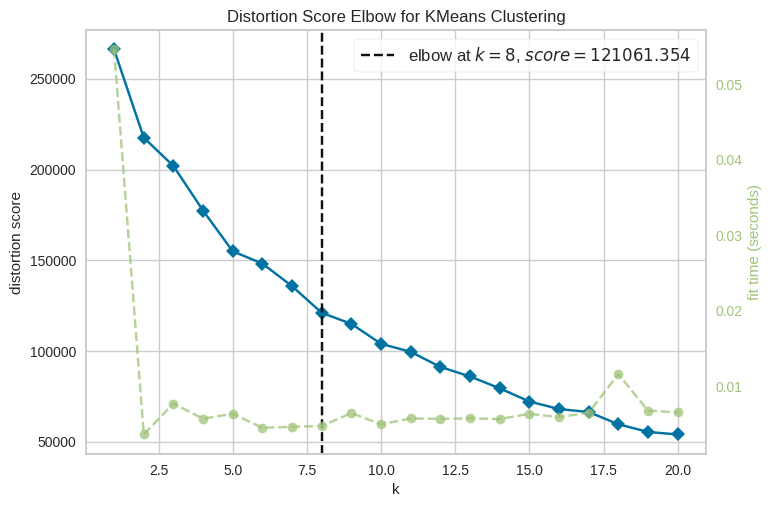

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [11]:
kmeans = KMeans(init = 'k-means++', random_state=42)
visualizer = KElbowVisualizer(kmeans, k=(1,21))
visualizer.fit(feature_return)
visualizer.show()

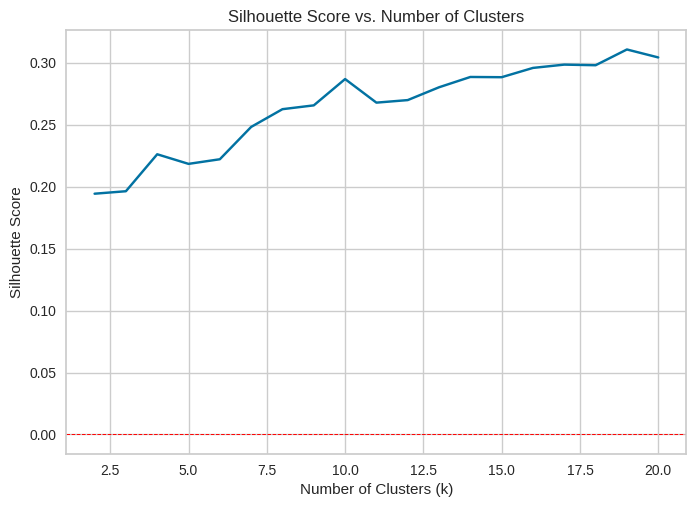

In [12]:
silhouette_scores = []
k_values = range(2, 21)

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(feature_return)

    score = silhouette_score(feature_return, labels)
    silhouette_scores.append(score)

plt.plot(k_values, silhouette_scores)
plt.axhline(0, color='red', linestyle='--', linewidth=0.7)
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score vs. Number of Clusters')
plt.show()

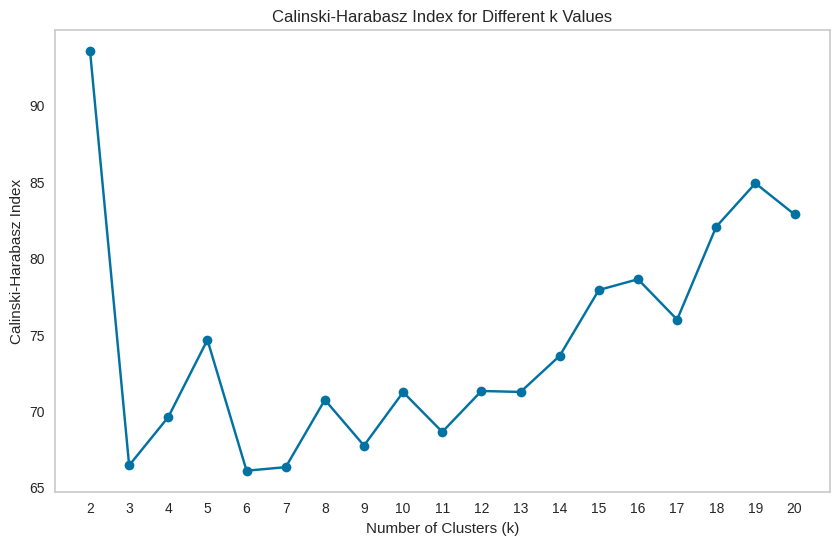

In [13]:
ch_scores = []
k_values = range(2, 21)

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(feature_return)
    ch_score = calinski_harabasz_score(feature_return, labels)
    ch_scores.append(ch_score)

plt.figure(figsize=(10, 6))
plt.plot(k_values, ch_scores, marker='o')
plt.title('Calinski-Harabasz Index for Different k Values')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Calinski-Harabasz Index')
plt.xticks(k_values)
plt.grid()
plt.show()

### Chosen Cluster Size

After applying multiple methods to determine the optimal number of clusters, I selected **8 clusters** as the ideal cluster size for my analysis. Although the metrics varied in their recommendations, here's how I arrived at this decision:

1. **Elbow Method**:  
   The elbow point was observed at 8 clusters, where the within-cluster sum of squares (WCSS) started to level off. The graph, however, was not entirely definitive, as one could also argue for 5 or 10 clusters based on subtle changes in the slope at these points.

2. **Silhouette Score**:  
   The silhouette score wasn't highest with 5 or 10 clusters, but have a peak at 10. The graph is increasing by the clustersize up to 17 clusters.

3. **Calinski-Harabasz Score**:
   The Calinski-Harabasz score showed a local peak at 5, 8 and 10 clusters. While 5 clusters achieved the highest local score, I opted for 8 clusters, as this choice is still supported by the Calinski-Harabasz criterion.

In summary, while both 5 and 10 clusters were supported by various metrics, I chose 10 clusters as it balanced the elbow, silhouette, and Calinski-Harabasz scores. This choice offers a manageable level of interpretability while effectively capturing key patterns in the data for deeper analysis.


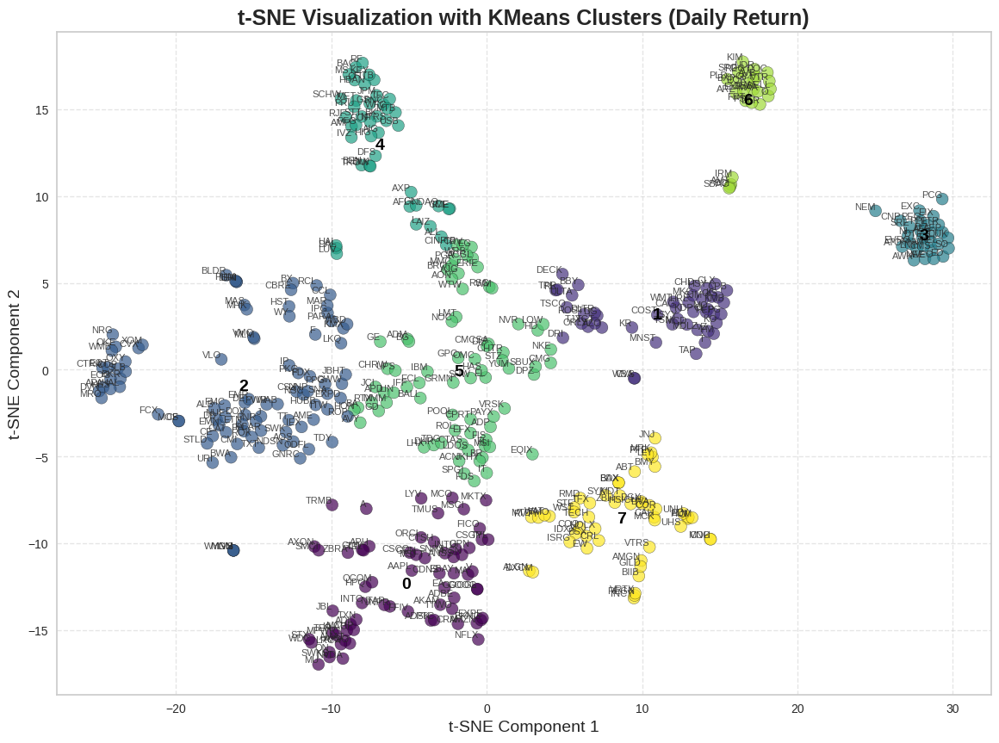

In [14]:
tsne = TSNE(n_components=2, random_state=42)
tsne_result = tsne.fit_transform(feature_return)

kmeans = KMeans(n_clusters=8, random_state=42)
result_return = kmeans.fit_predict(tsne_result)

result_return = pd.DataFrame(result_return, index=feature_return.index, columns=['Cluster'])

# Scatter plot for t-SNE clusters
plt.figure(figsize=(14, 10))
scatter = plt.scatter(tsne_result[:, 0], tsne_result[:, 1],
                      c=result_return['Cluster'], cmap='viridis', alpha=0.7, edgecolor='k', s=100)

for i, ticker in enumerate(result_return.index):
    plt.annotate(ticker, (tsne_result[i, 0], tsne_result[i, 1]), fontsize=8, alpha=0.8,
                 ha='right', va='bottom')

centers_tsne = kmeans.cluster_centers_

for cluster_num, center in enumerate(centers_tsne):
    plt.text(center[0], center[1], str(cluster_num), color="black", fontsize=14,
             fontweight='bold', ha='center', va='center')

plt.title('t-SNE Visualization with KMeans Clusters (Daily Return)', fontsize=18, fontweight='bold')
plt.xlabel('t-SNE Component 1', fontsize=14)
plt.ylabel('t-SNE Component 2', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.5)

plt.show()

Looking at the cluster plot, the decision to use **8 clusters** appears well-founded, with several clusters showing distinct separation. Notably, **Cluster 3 and 6** are clearly defined and well-separated from the others.

### **Cross-Tabbing Analysis**

Using **cross-tabbing** with S&P 500 sector data, I aim to gain insights into how clusters align with different sectors. By examining the distribution of sector labels across clusters, this analysis highlights patterns or predominant sectors within each cluster, providing a deeper understanding of sector-based composition and the potential drivers behind each grouping.

In the table below, several clusters are strongly dominated by a single sector, indicating clear sector-specific grouping:

1. **Cluster 6**: Healthcare — 50 out of 54 (92.59%)
2. **Cluster 7**: Real Estate — 24 out of 29 (82.76%)
3. **Cluster 4**: Financial Services — 41 out of 61 (67.21%)
4. **Cluster 3**: Utilities — 26 out of 27 (96.30%)

Clusters not listed here show a more mixed sector composition and do not have a dominant single-sector presence. This sector distribution insight reinforces the effectiveness of the clustering method in capturing sector-based similarities, while the mixed clusters may indicate broader or more diversified groupings.

In [15]:
result_return.reset_index(inplace=True)
result_return.rename(columns={'index': 'Ticker'}, inplace=True)

result_return_cross = sector_sp500.merge(result_return[['Ticker', 'Cluster']], on='Ticker', how='inner')

sector_cluster_return_crosstab = pd.crosstab(result_return_cross['Sector'], result_return_cross['Cluster'])
sector_cluster_return_crosstab.head(n=12)

Cluster,0,1,2,3,4,5,6,7
Sector,,,,,,,,
Basic Materials,0,0,13,1,0,5,0,0
Communication Services,7,2,3,0,0,4,0,0
Consumer Cyclical,4,12,16,0,0,13,0,0
Consumer Defensive,0,29,0,0,0,4,0,0
Energy,0,0,17,0,0,0,0,0
Financial Services,5,0,1,0,41,14,0,0
Healthcare,1,2,0,0,0,1,0,50
Industrials,2,0,35,0,3,20,0,0
Real Estate,1,0,3,0,0,1,24,0


##**2. Clustering - 30 days rolling volatility**

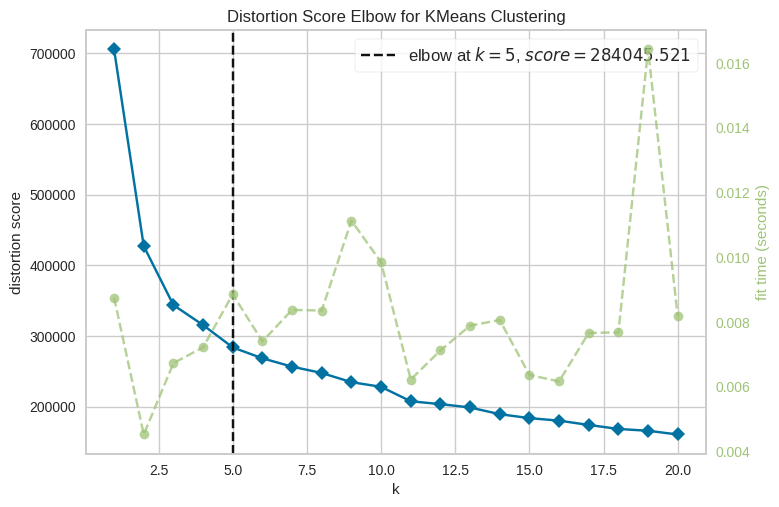

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [16]:
kmeans = KMeans(init = 'k-means++', random_state=42)
visualizer = KElbowVisualizer(kmeans, k=(1,21))
visualizer.fit(feature_volatility)
visualizer.show()

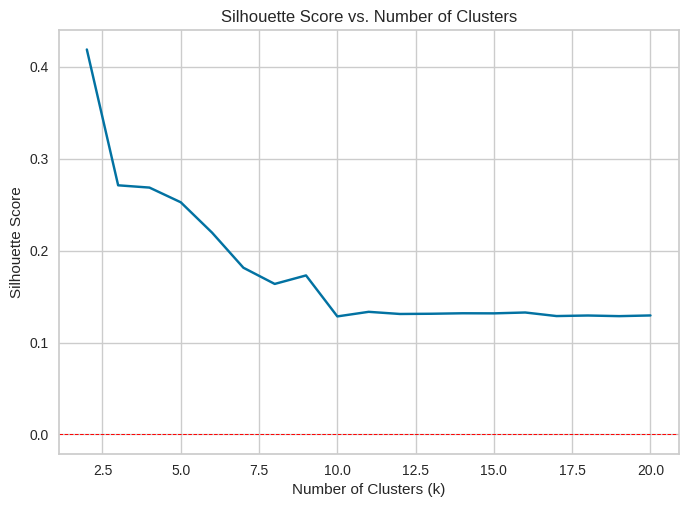

In [17]:
silhouette_scores = []
k_values = range(2, 21)

for k in k_values:

    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(feature_volatility)

    score = silhouette_score(feature_volatility, labels)
    silhouette_scores.append(score)

plt.plot(k_values, silhouette_scores)
plt.axhline(0, color='red', linestyle='--', linewidth=0.7)
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score vs. Number of Clusters')
plt.show()

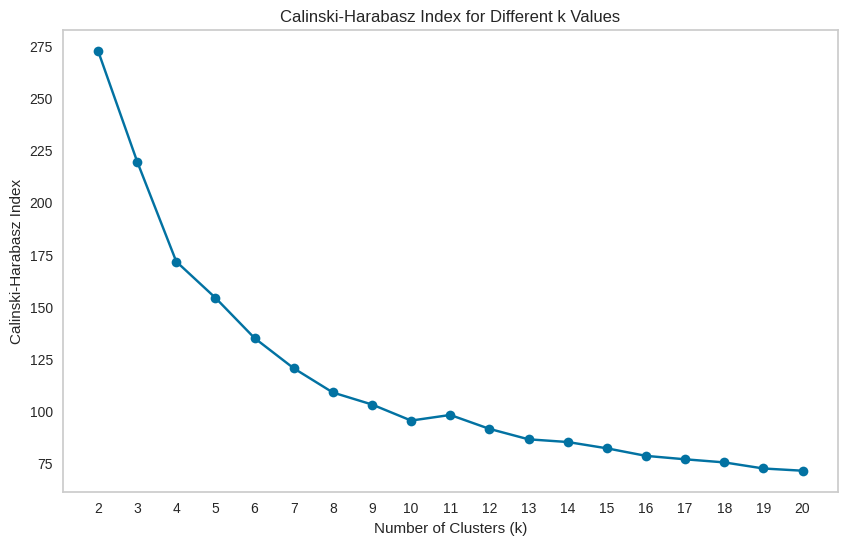

In [18]:
ch_scores = []
k_values = range(2, 21)

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(feature_volatility)
    ch_score = calinski_harabasz_score(feature_volatility, labels)
    ch_scores.append(ch_score)

plt.figure(figsize=(10, 6))
plt.plot(k_values, ch_scores, marker='o')
plt.title('Calinski-Harabasz Index for Different k Values')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Calinski-Harabasz Index')
plt.xticks(k_values)
plt.grid()
plt.show()

### Chosen Cluster Size
For volatility analysis, I again applied multiple methods to determine the optimal cluster size and chose **5 clusters** based on the following observations:
1. **Elbow Method**:
   The elbow point appeared at 5 clusters, with a possible additional elbow around 11 clusters. However, 5 clusters provided a clear turning point in the WCSS plot, making it a reasonable choice.
2. **Silhouette Score**:
   The silhouette score supported the 5-cluster choice, remaining positive, which indicates that the clusters are reasonably well-defined without overlap.
3. **Calinski-Harabasz Score**:
   Although the Calinski-Harabasz score decreased exponentially with increasing cluster size, 5 clusters had a high score (though not the absolute maximum), which can still be interpreted as support for the 5-cluster structure.

Together, these metrics suggested that 5 clusters offer a balanced and interpretable solution for analyzing volatility patterns.


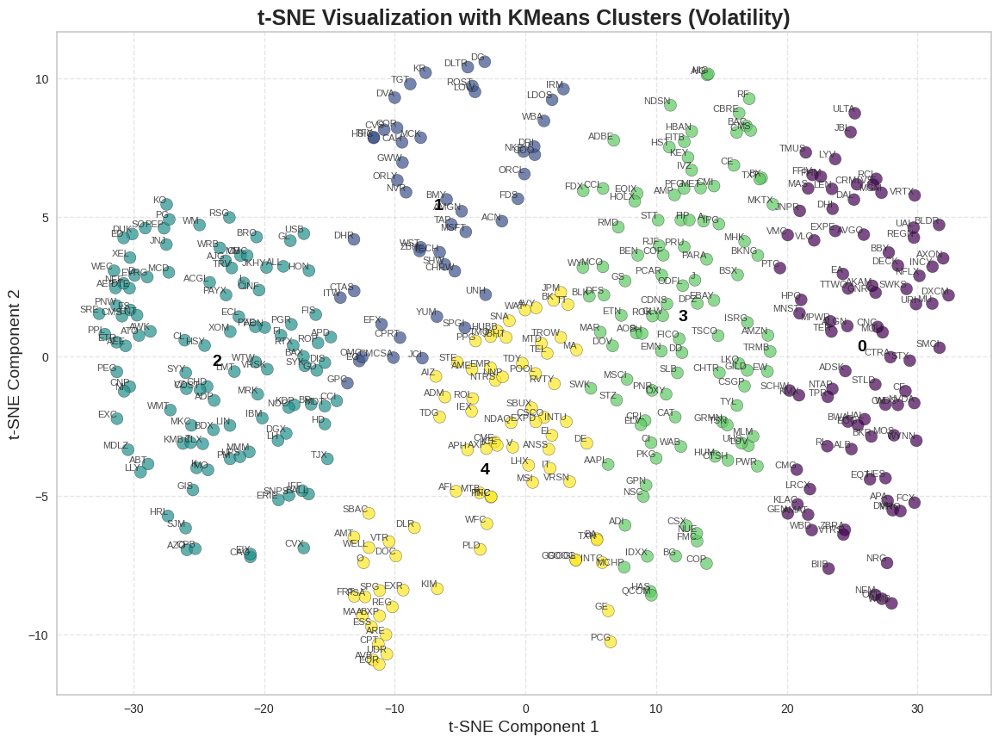

In [19]:
tsne = TSNE(n_components=2, random_state=42)
tsne_result = tsne.fit_transform(feature_volatility)

kmeans = KMeans(n_clusters=5, random_state=42)
result_volatility = kmeans.fit_predict(tsne_result)

result_volatility = pd.DataFrame(result_volatility, index=feature_volatility.index, columns=['Cluster'])

# Scatter plot for t-SNE clusters
plt.figure(figsize=(14, 10))
scatter = plt.scatter(tsne_result[:, 0], tsne_result[:, 1],
                      c=result_volatility['Cluster'], cmap='viridis', alpha=0.7, edgecolor='k', s=100)

for i, ticker in enumerate(feature_volatility.index):
    plt.annotate(ticker, (tsne_result[i, 0], tsne_result[i, 1]), fontsize=8, alpha=0.8,
                 ha='right', va='bottom')

centers_tsne = kmeans.cluster_centers_

for cluster_num, center in enumerate(centers_tsne):
    plt.text(center[0], center[1], str(cluster_num), color="black", fontsize=14,
             fontweight='bold', ha='center', va='center')

plt.title('t-SNE Visualization with KMeans Clusters (Volatility)', fontsize=18, fontweight='bold')
plt.xlabel('t-SNE Component 1', fontsize=14)
plt.ylabel('t-SNE Component 2', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.5)

plt.show()

The t-SNE visualization shows well-separated, distinct clusters overall, supporting the choice of 5 clusters as a meaningful way to group stocks based on volatility characteristics. However, Cluster 1 and 4 may benefit from further division, as it appears to contain two potential subgroups.

### **Cross-Tabbing Analysis**
In the table below, no clear structure emerges between the clusters and the S&P 500 sectors. This suggests that the clusters may capture patterns or relationships in the stock data that are not directly related to sector classification, possibly indicating other underlying factors influencing volatility.

In [20]:
result_volatility.reset_index(inplace=True)
result_volatility.rename(columns={'index': 'Ticker'}, inplace=True)

result_volatility_cross = sector_sp500.merge(result_volatility[['Ticker', 'Cluster']], on='Ticker', how='inner')

sector_cluster_volatility_crosstab = pd.crosstab(result_volatility_cross['Sector'], result_volatility_cross['Cluster'])
sector_cluster_volatility_crosstab.head(n=12)

Cluster,0,1,2,3,4
Sector,,,,,
Basic Materials,7,1,4,6,1
Communication Services,6,2,3,3,2
Consumer Cyclical,16,8,5,13,3
Consumer Defensive,1,5,22,3,2
Energy,12,0,2,3,0
Financial Services,1,3,16,25,16
Healthcare,9,16,11,13,5
Industrials,7,7,10,21,15
Real Estate,0,1,1,5,22


##**3. Clustering - Combine returns and volatility**

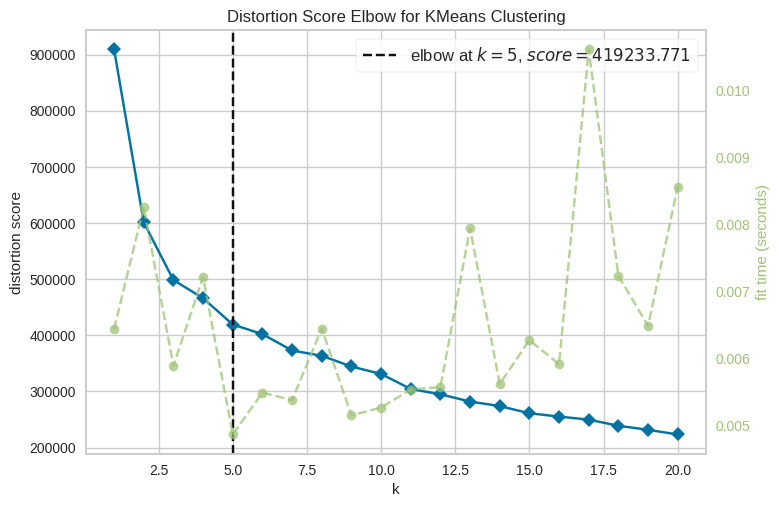

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [21]:
kmeans = KMeans(init = 'k-means++', random_state=42)
visualizer = KElbowVisualizer(kmeans, k=(1,21))
visualizer.fit(feature_combined)
visualizer.show()

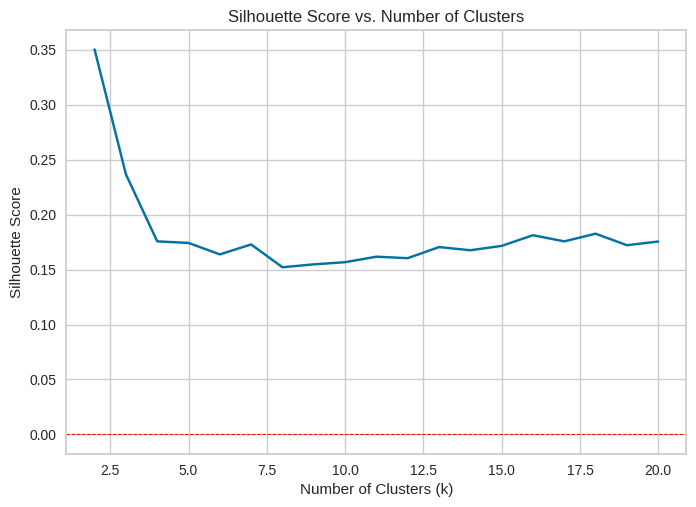

In [22]:
silhouette_scores = []
k_values = range(2, 21)

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(feature_combined)

    score = silhouette_score(feature_combined, labels)
    silhouette_scores.append(score)

plt.plot(k_values, silhouette_scores)
plt.axhline(0, color='red', linestyle='--', linewidth=0.7)
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score vs. Number of Clusters')
plt.show()

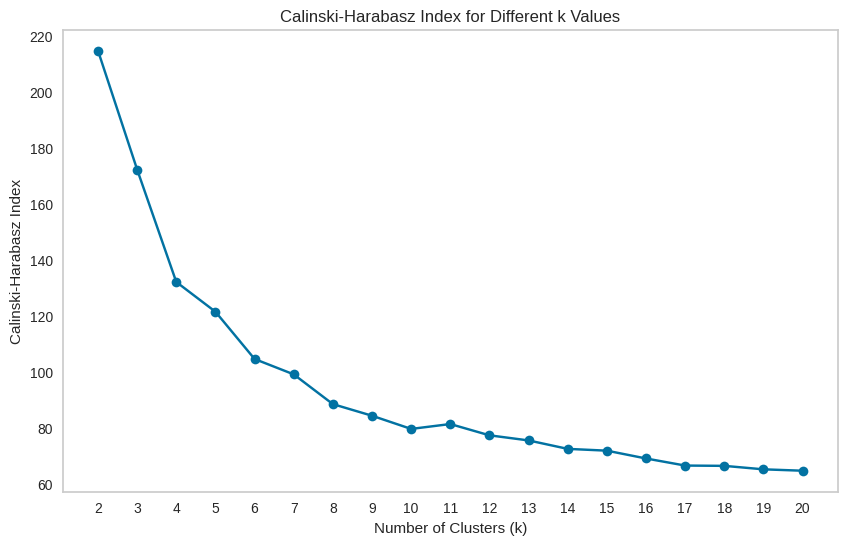

In [23]:
ch_scores = []
k_values = range(2, 21)

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(feature_combined)
    ch_score = calinski_harabasz_score(feature_combined, labels)
    ch_scores.append(ch_score)

plt.figure(figsize=(10, 6))
plt.plot(k_values, ch_scores, marker='o')
plt.title('Calinski-Harabasz Index for Different k Values')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Calinski-Harabasz Index')
plt.xticks(k_values)
plt.grid()
plt.show()

### Chosen Cluster Size
For the combined analysis, I applied multiple methods to determine the optimal cluster size and ultimately chose 5 clusters based on the following observations:

1. **Elbow Method**:
  The elbow point appeared at 5 clusters, with a potential additional elbow around 11 clusters. However, 5 clusters provided a clearer turning point in the WCSS plot, making it a more straightforward choice.

2. **Silhouette Score**:
  The silhouette score was positive at 5 clusters, indicating a reasonable separation between clusters. Although there was also a spike at 7 clusters, it wasn't substantial enough to override the choice of 5.

3. **Calinski-Harabasz Score**:
  The Calinski-Harabasz score supported 5 clusters as well, though 11 clusters was also a viable option.

In summary, these metrics suggested both 5 and 11 clusters as reasonable options. I opted for 5 clusters, as it provides a more interpretable grouping without excessive granularity.

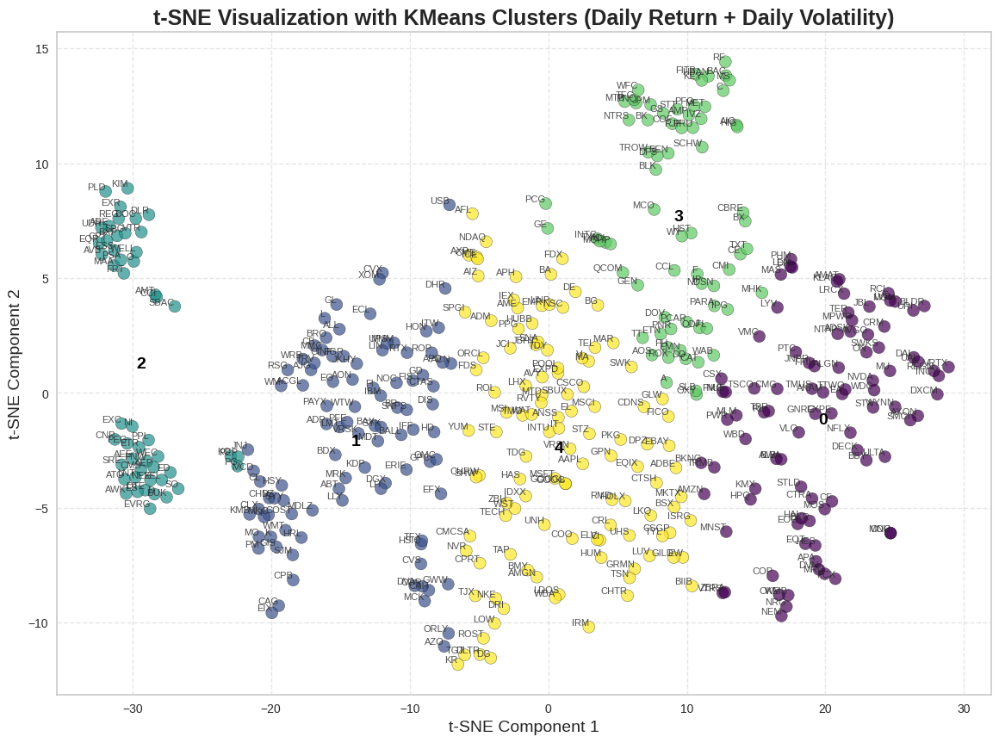

In [24]:
tsne = TSNE(n_components=2, random_state=42)
tsne_result = tsne.fit_transform(feature_combined)

kmeans = KMeans(n_clusters=5, random_state=42)
result_combined = kmeans.fit_predict(tsne_result)

result_combined = pd.DataFrame(result_combined, index=feature_combined.index, columns=['Cluster'])

# Scatter plot for t-SNE clusters
plt.figure(figsize=(14, 10))
scatter = plt.scatter(tsne_result[:, 0], tsne_result[:, 1],
                      c=result_combined['Cluster'], cmap='viridis', alpha=0.7, edgecolor='k', s=100)

for i, ticker in enumerate(feature_combined.index):
    plt.annotate(ticker, (tsne_result[i, 0], tsne_result[i, 1]), fontsize=8, alpha=0.8,
                 ha='right', va='bottom')

centers_tsne = kmeans.cluster_centers_

for cluster_num, center in enumerate(centers_tsne):
    plt.text(center[0], center[1], str(cluster_num), color="black", fontsize=14,
             fontweight='bold', ha='center', va='center')

plt.title('t-SNE Visualization with KMeans Clusters (Daily Return + Daily Volatility)', fontsize=18, fontweight='bold')
plt.xlabel('t-SNE Component 1', fontsize=14)
plt.ylabel('t-SNE Component 2', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.5)

plt.show()

The t-SNE visualization indicates that while some clusters are clearly defined, the structure suggests the need for additional clusters. Clusters 1, 2 and 3, in particular, appear to contain distinct subgroups. Based on this, selecting 11 clusters would better capture the nuanced patterns in the data.


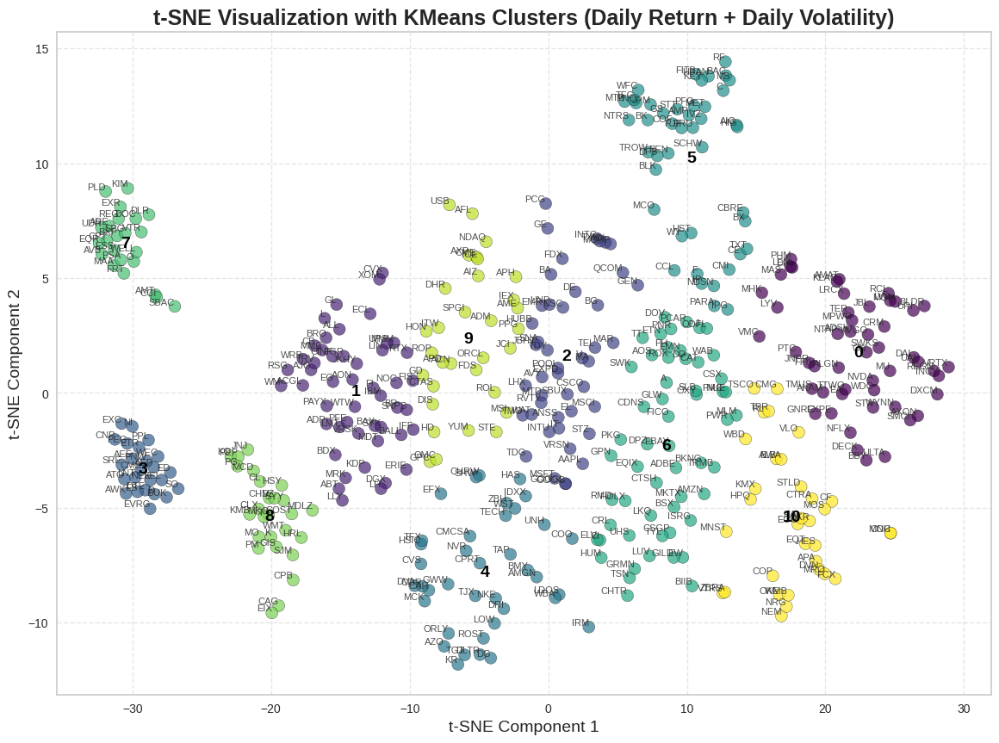

In [25]:
kmeans = KMeans(n_clusters=11, random_state=42)
result_combined_new = kmeans.fit_predict(tsne_result)

result_combined_new = pd.DataFrame(result_combined_new, index=feature_combined.index, columns=['Cluster'])

# Scatter plot for t-SNE clusters
plt.figure(figsize=(14, 10))
scatter = plt.scatter(tsne_result[:, 0], tsne_result[:, 1],
                      c=result_combined_new['Cluster'], cmap='viridis', alpha=0.7, edgecolor='k', s=100)

for i, ticker in enumerate(feature_combined.index):
    plt.annotate(ticker, (tsne_result[i, 0], tsne_result[i, 1]), fontsize=8, alpha=0.8,
                 ha='right', va='bottom')

centers_tsne = kmeans.cluster_centers_

for cluster_num, center in enumerate(centers_tsne):
    plt.text(center[0], center[1], str(cluster_num), color="black", fontsize=14,
             fontweight='bold', ha='center', va='center')

plt.title('t-SNE Visualization with KMeans Clusters (Daily Return + Daily Volatility)', fontsize=18, fontweight='bold')
plt.xlabel('t-SNE Component 1', fontsize=14)
plt.ylabel('t-SNE Component 2', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.5)

plt.show()

The t-SNE visualization shows improvement with 11 clusters; however, the structure remains somewhat ambiguous, indicating that the clusters are not fully distinct or well-separated.

### **Cross-Tabbing Analysis**
The table below reveals that no strong alignment exists between the clusters and S&P 500 sectors. Only cluster 3 shows a clear separation, consisting predominantly of stocks from the Real Estate sector. This indicates that the clusters may be identifying underlying patterns or relationships within the stock data that do not directly align with traditional sector classifications.

In [26]:
result_combined_new.reset_index(inplace=True)
result_combined_new.rename(columns={'index': 'Ticker'}, inplace=True)

result_combined_new_cross = sector_sp500.merge(result_combined_new[['Ticker', 'Cluster']], on='Ticker', how='inner')

sector_cluster_combined_new_crosstab = pd.crosstab(result_combined_new_cross['Sector'], result_combined_new_cross['Cluster'])
sector_cluster_combined_new_crosstab.head(n=12)

Cluster,0,1,2,3,4,5,6,7,8,9,10
Sector,,,,,,,,,,,
Basic Materials,1,3,0,0,1,1,5,0,0,2,6
Communication Services,5,0,2,0,1,2,1,0,2,2,1
Consumer Cyclical,12,1,3,0,9,3,6,0,1,4,6
Consumer Defensive,0,1,3,0,5,0,1,0,21,1,1
Energy,0,2,0,0,0,0,2,0,0,0,13
Financial Services,0,16,3,0,0,32,1,0,0,9,0
Healthcare,5,10,4,0,16,0,13,0,1,2,3
Industrials,7,8,14,0,4,3,17,0,0,7,0
Real Estate,0,0,0,0,1,3,2,23,0,0,0


#**Conclusion**
The clustering analysis of S&P 500 stocks, using various clustering methods and validation metrics, reveals meaningful groupings based on historical stock price performance from 2010 to 2020. The clusters highlight patterns that do not strictly fit traditional sector classifications, suggesting that the clustering captures unique market behaviours that may be related to volatility or trading patterns rather than sectoral factors alone.

I got the best result from clustering the daily returns. The 8 cluster configuration better represented the structure of the data in t-SNE visualisations, capturing underlying patterns that segment the market at a more granular level.

This analysis provides a basis for further exploration of the relationships between the clusters and the unique characteristics that drive each cluster. As a final step, I would seek to optimise the clusters for more than 8 and group well-defined clusters into sectors.

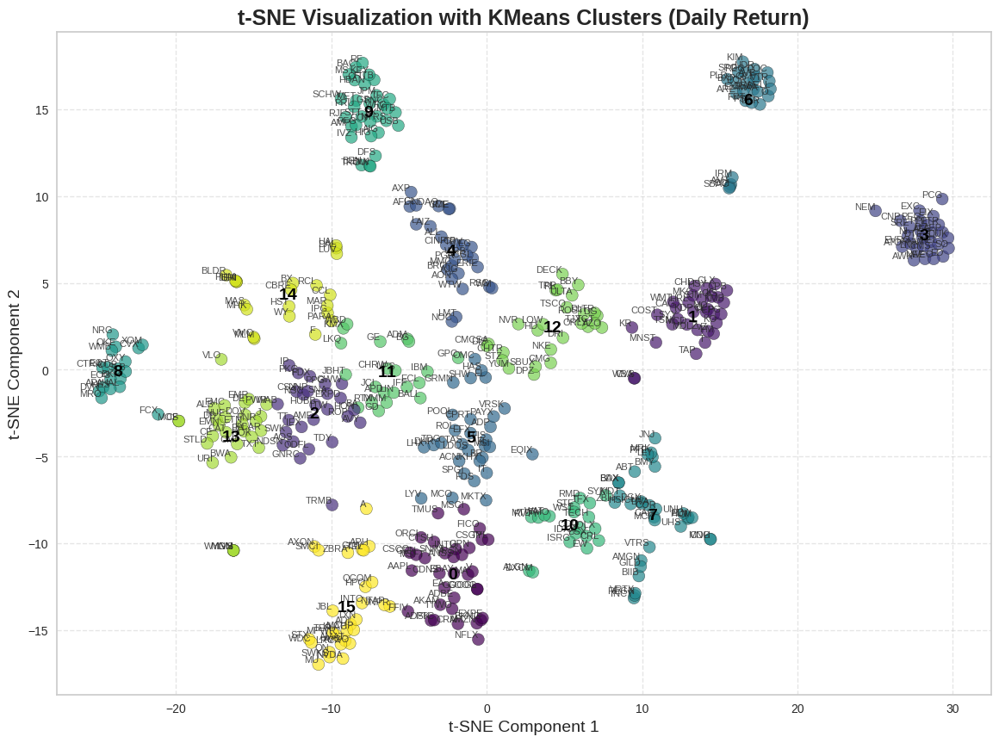

In [27]:
tsne = TSNE(n_components=2, random_state=42)
tsne_result = tsne.fit_transform(feature_return)

kmeans = KMeans(n_clusters=16, random_state=42)
result_return_new = kmeans.fit_predict(tsne_result)

result_return_new = pd.DataFrame(result_return_new, index=feature_return.index, columns=['Cluster'])

# Scatter plot for t-SNE clusters
plt.figure(figsize=(14, 10))
scatter = plt.scatter(tsne_result[:, 0], tsne_result[:, 1],
                      c=result_return_new['Cluster'], cmap='viridis', alpha=0.7, edgecolor='k', s=100)

for i, ticker in enumerate(result_return_new.index):
    plt.annotate(ticker, (tsne_result[i, 0], tsne_result[i, 1]), fontsize=8, alpha=0.8,
                 ha='right', va='bottom')

centers_tsne = kmeans.cluster_centers_

for cluster_num, center in enumerate(centers_tsne):
    plt.text(center[0], center[1], str(cluster_num), color="black", fontsize=14,
             fontweight='bold', ha='center', va='center')

plt.title('t-SNE Visualization with KMeans Clusters (Daily Return)', fontsize=18, fontweight='bold')
plt.xlabel('t-SNE Component 1', fontsize=14)
plt.ylabel('t-SNE Component 2', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.5)

plt.show()

In [28]:
result_return_new_cross = result_return_new
result_return_new_cross.reset_index(inplace=True)
result_return_new_cross.rename(columns={'index': 'Ticker'}, inplace=True)

result_return_new_cross = sector_sp500.merge(result_return_new_cross[['Ticker', 'Cluster']], on='Ticker', how='inner')

sector_cluster_return_crosstab_new = pd.crosstab(result_return_new_cross['Sector'], result_return_new_cross['Cluster'])
sector_cluster_return_crosstab_new.head(n=24)

Cluster,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
Sector,,,,,,,,,,,,,,,,
Basic Materials,0,0,1,1,0,1,0,0,1,0,0,4,0,9,2,0
Communication Services,6,2,0,0,0,2,0,0,0,0,0,1,3,0,2,0
Consumer Cyclical,4,1,3,0,0,2,0,0,0,0,0,4,19,4,8,0
Consumer Defensive,0,26,0,0,0,1,0,0,0,0,0,2,4,0,0,0
Energy,0,0,0,0,0,0,0,0,16,0,0,0,0,1,0,0
Financial Services,3,0,0,0,22,4,0,0,0,31,0,0,0,0,1,0
Healthcare,0,2,0,0,0,1,0,31,0,0,19,0,0,0,0,1
Industrials,1,0,19,0,4,7,0,0,0,0,0,9,0,14,5,1
Real Estate,1,0,0,0,0,1,24,0,0,0,0,0,0,0,3,0


After following the metrics for 16 Clusters (supported by Silhouette Score and Calinski-Harabasz Score), I can categocategorize more clusters into sectors. Now I fusing clusters, which are from the same sector.


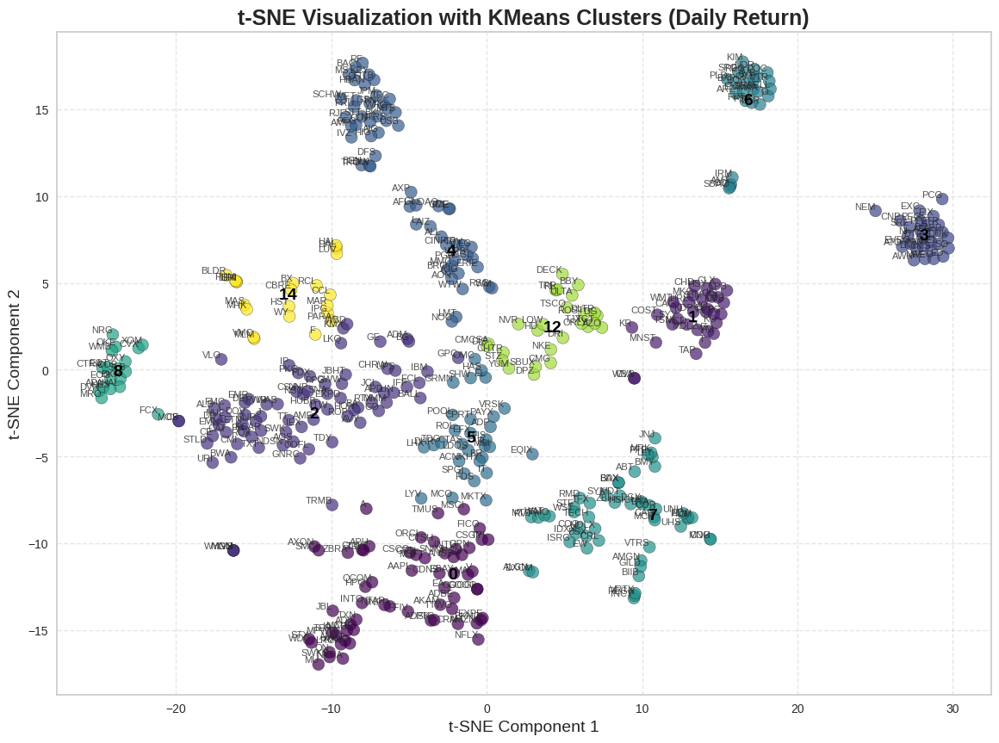

In [29]:
#Technology
result_return_new.loc[result_return_new['Cluster'].isin([0, 15]), 'Cluster'] = 0
#Industrials
result_return_new.loc[result_return_new['Cluster'].isin([2, 11, 13]), 'Cluster'] = 2
#Healcare
result_return_new.loc[result_return_new['Cluster'].isin([7, 10]), 'Cluster'] = 7
#Finance
result_return_new.loc[result_return_new['Cluster'].isin([4, 9]), 'Cluster'] = 4
#Border
#result_return_new.loc[result_return_new['Cluster'].isin([5, 11, 14]), 'Cluster'] = 5
# Scatter plot for t-SNE clusters
plt.figure(figsize=(14, 10))
scatter = plt.scatter(tsne_result[:, 0], tsne_result[:, 1],
                      c=result_return_new['Cluster'], cmap='viridis', alpha=0.7, edgecolor='k', s=100)

for i, ticker in enumerate(result_return_new['Ticker']):
    plt.annotate(ticker, (tsne_result[i, 0], tsne_result[i, 1]), fontsize=8, alpha=0.8,
                 ha='right', va='bottom')

centers_tsne = kmeans.cluster_centers_
new_cluster_labels = result_return_new['Cluster'].unique()

for cluster_num, center in enumerate(centers_tsne):
    cluster_rows = result_return_new[result_return_new['Cluster'] == cluster_num]

    if not cluster_rows.empty:
        cluster_label = cluster_rows['Cluster'].iloc[0]
    else:
      cluster_label = ''

    plt.text(center[0], center[1], str(cluster_label), color="black", fontsize=14,
             fontweight='bold', ha='center', va='center')

plt.title('t-SNE Visualization with KMeans Clusters (Daily Return)', fontsize=18, fontweight='bold')
plt.xlabel('t-SNE Component 1', fontsize=14)
plt.ylabel('t-SNE Component 2', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.5)

plt.show()

In [30]:
result_return_new_cross = result_return_new
result_return_new_cross.reset_index(inplace=True)
#result_return_new_cross.rename(columns={'index': 'Ticker'}, inplace=True)

result_return_new_cross = sector_sp500.merge(result_return_new_cross[['Ticker', 'Cluster']], on='Ticker', how='inner')

sector_cluster_return_crosstab_new = pd.crosstab(result_return_new_cross['Sector'], result_return_new_cross['Cluster'])
sector_cluster_return_crosstab_new.head(n=24)

Cluster,0,1,2,3,4,5,6,7,8,12,14
Sector,,,,,,,,,,,
Basic Materials,0,0,14,1,0,1,0,0,1,0,2
Communication Services,6,2,1,0,0,2,0,0,0,3,2
Consumer Cyclical,4,1,11,0,0,2,0,0,0,19,8
Consumer Defensive,0,26,2,0,0,1,0,0,0,4,0
Energy,0,0,1,0,0,0,0,0,16,0,0
Financial Services,3,0,0,0,53,4,0,0,0,0,1
Healthcare,1,2,0,0,0,1,0,50,0,0,0
Industrials,2,0,42,0,4,7,0,0,0,0,5
Real Estate,1,0,0,0,0,1,24,0,0,0,3


After combining some clusters using sector information, I obtained a mostly well-separated result that provides interesting insights into company groupings based on stock performance. For instance, I see that Cluster 8 primarily contains energy companies, Cluster 7 includes healthcare companies, and Cluster 4 is largely composed of financial services.

A few notable insights emerge in Clusters 2, 12, and 1. Cluster 2 includes both industrials and basic materials, which aligns well with an interpretation of these companies as part of the production side. Meanwhile, Clusters 1 and 12 group together companies from the consumer side, with cyclical and defensive consumer companies grouped separately. These three clusters, when combined, could plausibly represent a full lifecycle from raw materials through production to final consumer sales.

Additionally, Clusters 5 and 14 appear as potential "border clusters" between multiple sectors. On one hand, this may represent companies that share characteristics with multiple clusters, suggesting a cross-sector role. On the other hand, it could indicate the need for further hyperparameter tuning to refine cluster boundaries.